In [ ]:
  # %cd /content/

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
# !unzip /content/drive/MyDrive/Colab\ Notebooks/MEDAI_DEC/archive.zip -d /content/

In [ ]:
# !pip install torchview

In [ ]:
%cd /content

/content


In [ ]:
cfg_path= "/content/lgg-mri-segmentation/kaggle_3m"

import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torchsummary import summary
from torchview import draw_graph
import torch.optim.lr_scheduler as lr_scheduler

import matplotlib.pyplot as plt
from tqdm import tqdm
import glob
import numpy as np
import pandas as pd
import seaborn as sns
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_fscore_support, accuracy_score, f1_score, matthews_corrcoef


import random
from collections import defaultdict
import os
import shutil
import copy
from typing import Dict, List, Tuple
import graphviz


# /content/lgg-mri-segmentation/kaggle_3m/TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_1.tif

In [ ]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

BATCH_SIZE = (
        32 if torch.cuda.device_count() < 2
        else (32 * torch.cuda.device_count())
    )
seed =768
NUM_WORKERS = os.cpu_count()

LR = 1e-4
PATIENCE= 8
EPOCHS=100

NUM_DEVICES = torch.cuda.device_count()



In [ ]:
NUM_DEVICES

1

In [ ]:
# Fetching files from the directory
file_list= glob.glob(cfg_path+"/*/*.tif", recursive= True)

In [ ]:
len(file_list)

7858

In [ ]:
file_list[:5]

['/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_6.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_17_mask.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_5_mask.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_29.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_29_mask.tif']

In [ ]:
# ID sorting for each scan

fl_copy= file_list

In [ ]:
def get_sample_numbers(image_paths):
  sample_numbers= []
  is_mask= []
  for f in image_paths:
    path_list= f.split('/')[-2:][1].split('_')
    print(path_list)

    if 'mask.tif' in path_list:
      sample_numbers.append(int(path_list[-2]))
      is_mask.append(1)
      print(is_mask)
      print(sample_numbers)
    else:
      sample_numbers.append(int(path_list[-1].replace('.tif', '')))
      is_mask.append(0)

  return sample_numbers, is_mask

def get_sample_patient_id(image_paths):
  return [(id_.split('/')[-2:][0]) for id_ in image_paths]



In [ ]:
get_sample_numbers(file_list)

['TCGA', 'DU', '7300', '19910814', '6.tif']
['TCGA', 'DU', '7300', '19910814', '17', 'mask.tif']
[0, 1]
[6, 17]
['TCGA', 'DU', '7300', '19910814', '5', 'mask.tif']
[0, 1, 1]
[6, 17, 5]
['TCGA', 'DU', '7300', '19910814', '29.tif']
['TCGA', 'DU', '7300', '19910814', '29', 'mask.tif']
[0, 1, 1, 0, 1]
[6, 17, 5, 29, 29]
['TCGA', 'DU', '7300', '19910814', '27', 'mask.tif']
[0, 1, 1, 0, 1, 1]
[6, 17, 5, 29, 29, 27]
['TCGA', 'DU', '7300', '19910814', '25.tif']
['TCGA', 'DU', '7300', '19910814', '27.tif']
['TCGA', 'DU', '7300', '19910814', '10.tif']
['TCGA', 'DU', '7300', '19910814', '7', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7]
['TCGA', 'DU', '7300', '19910814', '11', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11]
['TCGA', 'DU', '7300', '19910814', '21.tif']
['TCGA', 'DU', '7300', '19910814', '18', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18]
['TCGA', 'DU',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7013', '19860523', '12.tif']
['TCGA', 'DU', '7013', '19860523', '12', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18, 26, 33, 23, 35, 5, 36, 19, 9, 16, 24, 30, 12, 12, 9, 14, 3, 33, 4, 22, 7, 10, 16, 36, 14, 8, 34, 13, 25, 2, 23, 31, 18, 8, 32, 15, 34, 11, 22, 1, 21, 32, 28, 20, 28, 4, 26, 17, 24, 20, 13, 1, 30, 2, 19, 15, 35, 31, 6, 3, 5, 7, 17, 17, 18, 11, 4, 10, 11, 9, 20, 4, 16, 8, 12, 3, 12, 10, 14, 13, 1, 2, 14, 18, 5, 19, 7, 9, 3, 8, 19, 6, 15, 6, 13, 15, 1, 16, 2, 20, 7, 31, 33, 20, 27, 29, 14, 1, 28, 4, 3, 2, 9, 34, 22, 30, 17, 23, 13, 32, 7, 14, 8, 35, 15, 25, 18, 24, 1, 28, 11, 11, 16, 20, 21, 27, 26, 30, 22, 6, 9, 8, 2, 18, 4, 5, 6, 24, 26, 35, 19, 15, 5, 21, 10, 32, 10, 23, 33, 3, 12, 17, 13, 25, 36, 29, 12, 31, 16, 19, 36, 34, 1, 11, 28, 27, 14, 32, 11, 28, 33, 38, 19, 8, 30, 15, 35, 16, 22, 29, 21, 31, 8, 36, 3, 10, 25, 22, 34, 30, 2, 21, 15, 19, 16, 9, 12, 2, 34, 31, 24, 18, 23, 10, 17, 9, 5, 32, 29, 7, 20, 26, 1, 26, 36, 6, 13, 4, 37, 27, 38, 14, 20, 24, 13, 18, 4, 33, 37, 3, 17, 7, 6, 23, 5, 35, 25, 12, 7, 14, 6, 11, 19, 6, 8, 17, 10,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'HT', '7616', '19940813', '5.tif']
['TCGA', 'HT', '7616', '19940813', '23.tif']
['TCGA', 'HT', '7616', '19940813', '12.tif']
['TCGA', 'HT', '7616', '19940813', '19.tif']
['TCGA', 'HT', '7616', '19940813', '2', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'HT', '8563', '19981209', '5', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'FG', '6691', '20020405', '17', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

([6,
  17,
  5,
  29,
  29,
  27,
  25,
  27,
  10,
  7,
  11,
  21,
  18,
  26,
  33,
  23,
  35,
  5,
  36,
  19,
  9,
  16,
  24,
  30,
  12,
  12,
  9,
  14,
  3,
  33,
  4,
  22,
  7,
  10,
  16,
  36,
  14,
  8,
  34,
  13,
  25,
  2,
  23,
  31,
  18,
  8,
  32,
  15,
  34,
  11,
  22,
  1,
  21,
  32,
  28,
  20,
  28,
  4,
  26,
  17,
  24,
  20,
  13,
  1,
  30,
  2,
  19,
  15,
  35,
  31,
  6,
  3,
  5,
  7,
  17,
  17,
  18,
  11,
  4,
  10,
  11,
  9,
  20,
  4,
  16,
  8,
  12,
  3,
  12,
  10,
  14,
  13,
  1,
  2,
  14,
  18,
  5,
  19,
  7,
  9,
  3,
  8,
  19,
  6,
  15,
  6,
  13,
  15,
  1,
  16,
  2,
  20,
  7,
  31,
  33,
  20,
  27,
  29,
  14,
  1,
  28,
  4,
  3,
  2,
  9,
  34,
  22,
  30,
  17,
  23,
  13,
  32,
  7,
  14,
  8,
  35,
  15,
  25,
  18,
  24,
  1,
  28,
  11,
  11,
  16,
  20,
  21,
  27,
  26,
  30,
  22,
  6,
  9,
  8,
  2,
  18,
  4,
  5,
  6,
  24,
  26,
  35,
  19,
  15,
  5,
  21,
  10,
  32,
  10,
  23,
  33,
  3,
  12,
  17,
  13,
  25

In [ ]:
get_sample_patient_id(file_list)

['TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_73

In [ ]:
def build_df(image_paths):
  sample_numbers, mask_label= get_sample_numbers(image_paths)
  sample_df= pd.DataFrame({
      'id': sample_numbers ,
      'patient': get_sample_patient_id(image_paths),
      'image_path': image_paths,
      'is_mask': mask_label,

  })
  return sample_df

In [ ]:
dataset_df=(build_df(file_list).sort_values(by= ['id', 'patient', 'image_path']).reset_index(drop= True))

['TCGA', 'DU', '7300', '19910814', '6.tif']
['TCGA', 'DU', '7300', '19910814', '17', 'mask.tif']
[0, 1]
[6, 17]
['TCGA', 'DU', '7300', '19910814', '5', 'mask.tif']
[0, 1, 1]
[6, 17, 5]
['TCGA', 'DU', '7300', '19910814', '29.tif']
['TCGA', 'DU', '7300', '19910814', '29', 'mask.tif']
[0, 1, 1, 0, 1]
[6, 17, 5, 29, 29]
['TCGA', 'DU', '7300', '19910814', '27', 'mask.tif']
[0, 1, 1, 0, 1, 1]
[6, 17, 5, 29, 29, 27]
['TCGA', 'DU', '7300', '19910814', '25.tif']
['TCGA', 'DU', '7300', '19910814', '27.tif']
['TCGA', 'DU', '7300', '19910814', '10.tif']
['TCGA', 'DU', '7300', '19910814', '7', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7]
['TCGA', 'DU', '7300', '19910814', '11', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11]
['TCGA', 'DU', '7300', '19910814', '21.tif']
['TCGA', 'DU', '7300', '19910814', '18', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18]
['TCGA', 'DU',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18, 26, 33, 23, 35, 5, 36, 19, 9, 16, 24, 30, 12, 12, 9, 14, 3, 33, 4, 22, 7, 10, 16, 36, 14, 8, 34, 13, 25, 2, 23, 31, 18, 8, 32, 15, 34, 11, 22, 1, 21, 32, 28, 20, 28, 4, 26, 17, 24, 20, 13, 1, 30, 2, 19, 15, 35, 31, 6, 3, 5, 7, 17, 17, 18, 11, 4, 10, 11, 9, 20, 4, 16, 8, 12, 3, 12, 10, 14, 13, 1, 2, 14, 18, 5, 19, 7, 9, 3, 8, 19, 6, 15, 6, 13, 15, 1, 16, 2, 20, 7, 31, 33, 20, 27, 29, 14, 1, 28, 4, 3, 2, 9, 34, 22, 30, 17, 23, 13, 32, 7, 14, 8, 35, 15, 25, 18, 24, 1, 28, 11, 11, 16, 20, 21, 27, 26, 30, 22, 6, 9, 8, 2, 18, 4, 5, 6, 24, 26, 35, 19, 15, 5, 21, 10, 32, 10, 23, 33, 3, 12, 17, 13, 25, 36, 29, 12, 31, 16, 19, 36, 34, 1, 11, 28, 27, 14, 32, 11, 28, 33, 38, 19, 8, 30, 15, 35, 16, 22, 29, 21, 31, 8, 36, 3, 10, 25, 22, 34, 30, 2, 21, 15, 19, 16, 9, 12, 2, 34, 31, 24, 18, 23, 10, 17, 9, 5, 32, 29, 7, 20, 26, 1, 26, 36, 6, 13, 4, 37, 27, 38, 14, 20, 24, 13, 18, 4, 33, 37, 3, 17, 7, 6, 23, 5, 35, 25, 12, 7, 14, 6, 11, 19, 6, 8, 17, 10,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'HT', '7881', '19981015', '79', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7010', '19860307', '3', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7014', '19860618', '31', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18, 26, 33, 23, 35, 5, 36, 19, 9, 16, 24, 30, 12, 12, 9, 14, 3, 33, 4, 22, 7, 10, 16, 36, 14, 8, 34, 13, 25, 2, 23, 31, 18, 8, 32, 15, 34, 11, 22, 1, 21, 32, 28, 20, 28, 4, 26, 17, 24, 20, 13, 1, 30, 2, 19, 15, 35, 31, 6, 3, 5, 7, 17, 17, 18, 11, 4, 10, 11, 9, 20, 4, 16, 8, 12, 3, 12, 10, 14, 13, 1, 2, 14, 18, 5, 19, 7, 9, 3, 8, 19, 6, 15, 6, 13, 15, 1, 16, 2, 20, 7, 31, 33, 20, 27, 29, 14, 1, 28, 4, 3, 2, 9, 34, 22, 30, 17, 23, 13, 32, 7, 14, 8, 35, 15, 25, 18, 24, 1, 28, 11, 11, 16, 20, 21, 27, 26, 30, 22, 6, 9, 8, 2, 18, 4, 5, 6, 24, 26, 35, 19, 15, 5, 21, 10, 32, 10, 23, 33, 3, 12, 17, 13, 25, 36, 29, 12, 31, 16, 19, 36, 34, 1, 11, 28, 27, 14, 32, 11, 28, 33, 38, 19, 8, 30, 15, 35, 16, 22, 29, 21, 31, 8, 36, 3, 10, 25, 22, 34, 30, 2, 21, 15, 19, 16, 9, 12, 2, 34, 31, 24, 18, 23, 10, 17, 9, 5, 32, 29, 7, 20, 26, 1, 26, 36, 6, 13, 4, 37, 27, 38, 14, 20, 24, 13, 18, 4, 33, 37, 3, 17, 7, 6, 23, 5, 35, 25, 12, 7, 14, 6, 11, 19, 6, 8, 17, 10

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7301', '19911112', '3.tif']
['TCGA', 'DU', '7301', '19911112', '5', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
dataset_df.head()

,id,patient,image_path,is_mask
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
1,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,1
2,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
3,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,1
4,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0


In [ ]:
#Group Samples by mask status

grouped_df= dataset_df.groupby(by= 'is_mask')

image_df, mask_df= (grouped_df.get_group(0).drop('is_mask', axis= 1).reset_index(drop=True),
                    grouped_df.get_group(1).drop('is_mask', axis= 1).reset_index(drop=True)
)



In [ ]:
mask_df= mask_df.rename({'image_path' : 'mask_path'}, axis=1)

In [ ]:
mask_df

,id,patient,mask_path
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...


In [ ]:
def _load(image_path, as_tensor= True):
  image=Image.open(image_path)
  image= np.array(image).astype(np.float32) / 255.
  return image

def generate_label(mask_path, load_fn):
  mask= load_fn(mask_path)
  if mask.max() > 0:
    return 1
  return 0

In [ ]:
ds= image_df.merge(mask_df, on=['id', 'patient'], how='left')



In [ ]:
ds

,id,patient,image_path,mask_path
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
...,...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...


In [ ]:
ds['diagnosis'] = [generate_label(_, _load) for _ in tqdm(ds['mask_path'])]

100%|██████████| 3929/3929 [00:09<00:00, 417.39it/s]


In [ ]:
ds

,id,patient,image_path,mask_path,diagnosis
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
...,...,...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0


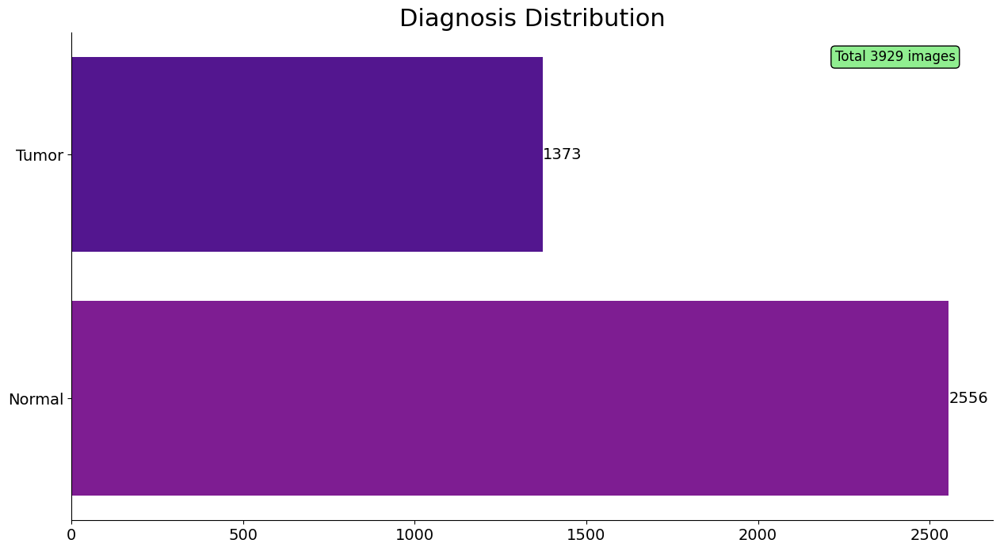

In [ ]:
# To View Diagnosis Distribution

fig= plt.figure(figsize= (15,8))

plt.title("Diagnosis Distribution", fontsize= 22)

diagnosis_distribution =ds['diagnosis'].value_counts().sort_values()
diagnosis_map = {0 : 'Normal', 1 : 'Tumor'}

bar_plot= sns.barplot(
    x= diagnosis_distribution.values,
    y= [diagnosis_map[_] for _ in diagnosis_distribution.keys()],
    palette= sns.color_palette("plasma"),
    orient= 'h'
)

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14)

plt.xticks(fontsize= 14)
plt.yticks(fontsize= 14)

text_params= {
    'x' : 2400,
    'y' : -0.4,
    's' : f"Total {len(ds)} images",
    'size' : 12,
    'color' : "Black",
    'ha'    : "center",
    'va'    : "center",
    'bbox'  : dict(boxstyle= "round", fc= ("lightgreen"), ec= ("black"))

}
plt.text(**text_params)

sns.despine()




diagnosi_map= [_ for _ in diagnosis_distribution.keys()]


In [ ]:
def view_sample(image, mask, color_map= 'rgb', fig_size= (16,8), title_size= 18):
  plt.figure(figsize= fig_size);
  plt.tight_layout();
  plt.subplots_adjust(top= 0.95);

  plt.subplot(1,3, 1);
  plt.title("MRI", fontsize= title_size);
  if color_map == "rgb":
    plt.imshow(image);
  else:
    plt.imshow(image, cmap= color_map);

  plt.subplot(1, 3, 2);
  plt.title("Mask", fontsize= title_size);
  plt.imshow(mask, cmap= "gray");

  plt.subplot(1, 3, 3);
  plt.title("MRI + Mask", fontsize= title_size);

  if color_map == "rgb":
    plt.imshow(image)
  else:
    plt.imshow(image, cmap= color_map)

  plt.imshow(mask, cmap="gray", alpha= 0.5);

  return








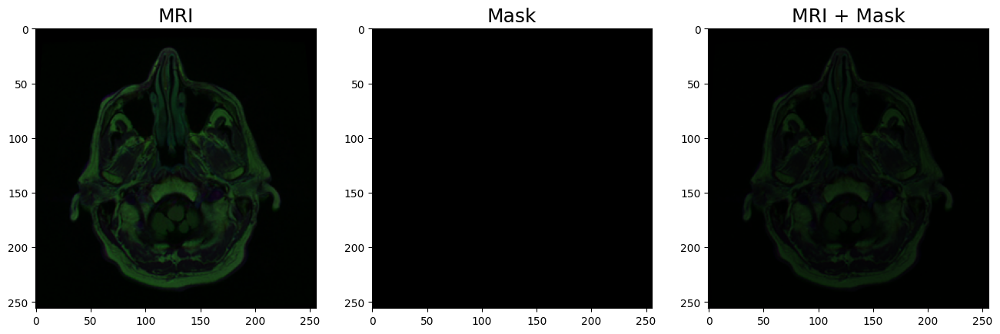

In [ ]:
rd_num= random.sample(ds.index.to_list(), 1)[0]

sample_image, sample_mask= _load(ds.image_path[rd_num]),  _load(ds.mask_path[rd_num])

view_sample(sample_image, sample_mask, color_map= 'mako')

In [ ]:
def view_multiple_sample(df, sample_loader, count= 10, color_map= "rgb", fig_size= (14, 10) ,title_size= 18):

  rd_num= random.sample(df.index.to_list(), count)

  plt.figure(figsize= fig_size);
  plt.tight_layout();
  plt.subplots_adjust(top= 0.95)

  for x, y in enumerate(rd_num):
    image, mask= (
        sample_loader(df.image_path[y]),
        sample_loader(df.mask_path[y])
  )

    idx= 3 * (x+1)

    plt.subplot(count+1, 3, idx+1);
    plt.title("MRI", fontsize= title_size);
    if color_map== "rgb":
      plt.imshow(image);
    else:
      plt.imshow(image, cmap= color_map);

    plt.subplot(count+1, 3, idx+2);
    plt.title("Mask", fontsize= title_size);
    plt.imshow(mask, cmap= "gray")

    plt.subplot(count+1, 3, idx+3)
    plt.title("MRI + MASK", fontsize= title_size)
    if color_map== "rgb":
      plt.imshow(image)
    else:
      plt.imshow(image, cmap= color_map)
    plt.imshow(mask, cmap ="gray", alpha= 0.5)

  return




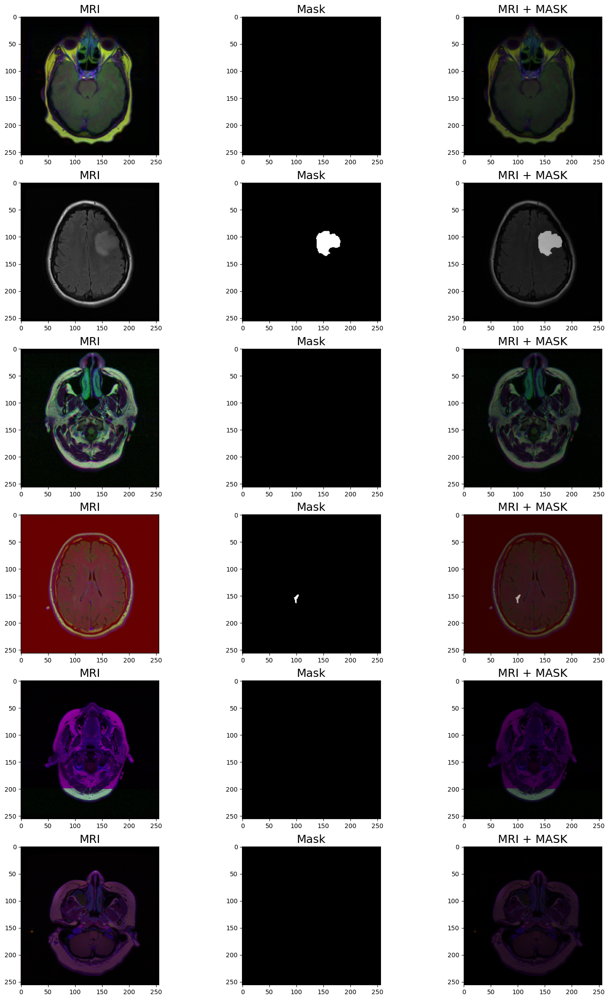

In [ ]:
view_multiple_sample(ds, _load, count=6, color_map = "mako", fig_size= (18, 30)  )


In [ ]:
# Splitting the dataset for training


train_split_idx, data_split_idx, _, _= train_test_split(ds.index, ds.diagnosis, test_size= 0.30, stratify= ds.diagnosis, random_state= seed)

In [ ]:
train_df= ds.iloc[train_split_idx].reset_index(drop=True)
data_df= ds.iloc[data_split_idx].reset_index(drop=True)

In [ ]:
print(train_df.shape)
print(data_df.shape)

(2750, 5)
(1179, 5)


In [ ]:
val_split_idx, test_split_idx, _, _ = train_test_split(data_df.index, data_df.diagnosis, test_size= 0.65, stratify = data_df.diagnosis, random_state= seed )

In [ ]:
val_df= data_df.iloc[val_split_idx].reset_index(drop= True)
test_df= data_df.iloc[test_split_idx].reset_index(drop= True)

In [ ]:
print(val_df.shape)
print(test_df.shape)

(412, 5)
(767, 5)


In [ ]:
train_size= len(train_df)
test_size= len(test_df)
val_size= len(val_df)
total_size= train_size + test_size + val_size

print("===================================================")
print(f'Training Sample Size:\t\t{train_size}\t({(100 * train_size/total_size):.2f}%)')
print(f'Testing Sample Size:\t\t{test_size}\t({(100 * test_size/total_size):.2f}%)')
print(f'Validation Sample Size:\t\t{val_size}\t({(100 * val_size/total_size):.2f}%)')
print("===================================================")

print(f'Total \t\t\t\t{total_size}\t({(100 * total_size/total_size):.2f}%)')


Training Sample Size:		2750	(69.99%)
Testing Sample Size:		767	(19.52%)
Validation Sample Size:		412	(10.49%)
Total 				3929	(100.00%)


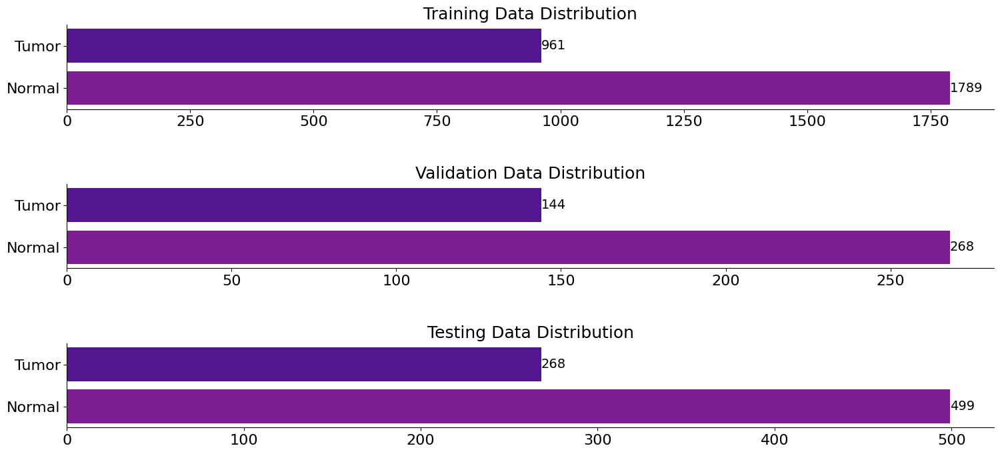

In [ ]:
fig, (ax1, ax2, ax3)= plt.subplots(3, figsize= (16, 8))
fig.tight_layout(pad= 6.0)

sns.despine()

#Train distribution
ax1.set_title("Training Data Distribution", fontsize= 18)
train_distribution= train_df['diagnosis'].value_counts().sort_values()
distribution_map = {0: 'Normal', 1 : 'Tumor'}

bar_plot= sns.barplot(
    x= train_distribution.values,
    y= [distribution_map[_] for _ in train_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax1

);

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt='%.0f', fontsize= 14);

# Axis tick parameters
ax1.tick_params(axis= 'both', which= 'major', labelsize= 16);

#Validation data distribution
ax2.set_title("Validation Data Distribution", fontsize= 18)
val_distribution= val_df['diagnosis'].value_counts().sort_values()

bar_plot= sns.barplot(
    x= val_distribution.values,
    y= [distribution_map[_] for _ in val_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax2

)
for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14)

# Axis tick parameters
ax2.tick_params(axis= 'both', which= 'major', labelsize=16);

#Test data distribution
ax3.set_title("Testing Data Distribution", fontsize= 18)
test_distribution= test_df['diagnosis'].value_counts().sort_values()

bar_plot= sns.barplot(
    x= test_distribution.values,
    y= [distribution_map[_] for _ in test_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax3

)

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14 )

#axis Parameters
ax3.tick_params(axis= 'both', which= 'major', labelsize= 16)






In [ ]:

#Augment train data
train_transforms= A.Compose([
    A.Resize(224, 224, p=1.0),
    A.RandomBrightnessContrast(p=0.2),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    ToTensorV2(),
])

# Reshape Inference data

inference_transforms= A.Compose([
    A.Resize(224, 224, p=1.0),
    ToTensorV2(),
])


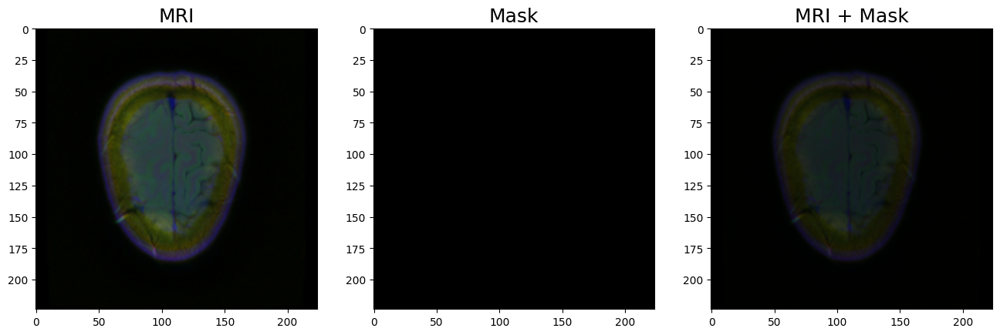

In [ ]:
# Select random sample from train_df
idx= random.sample(train_df.index.to_list(), 1)[0]

# Load the random sample and label
sample_image, sample_label= _load(train_df.image_path[idx]), _load(train_df.mask_path[idx])

aug= train_transforms(image= sample_image, mask= sample_label)

# View the random sample
view_sample(image= aug['image'].permute(1,2,0), mask= aug['mask'].unsqueeze_(0).permute(1,2,0), color_map= 'mako')


In [ ]:
class MRISegmentationDataset(Dataset):
  def __init__(self, df:pd.DataFrame, transform= None) -> None:
    super().__init__()

    self.mri_paths= df['image_path'].to_list()
    self.mask_paths= df['mask_path'].to_list()

    self.transform= transform

  def load_sample(self, index:str) -> Image.Image:
    image_path= self.mri_paths[index]
    mask_path= self.mask_paths[index]

    image= Image.open(image_path)
    mask= Image.open(mask_path)

    image= np.array(image).astype(np.float32) /255.
    mask= np.array(mask).astype(np.float32) /255.


    return image, mask

  def __len__(self) -> int:
    return self.mri_paths.__len__()

  def __getitem__(self, index:int) -> Tuple[torch.Tensor, torch.Tensor]:
    image,mask = self.load_sample(index)

    if self.transform:
      transformed= self.transform(image= image, mask= mask)
      return transformed['image'], transformed['mask'].unsqueeze_(0)
    else:
      transformed= ToTensorV2()(image= image, mask=mask)
      return transformed['image'], transformed['mask'].unsqueeze_(0)








In [ ]:
#Building Datasets
train_ds= MRISegmentationDataset(train_df, transform= train_transforms)

val_ds= MRISegmentationDataset(val_df, transform= inference_transforms)

test_ds= MRISegmentationDataset(test_df, transform= inference_transforms)


In [ ]:
#Building Dataloaders



train_dl= DataLoader(dataset= train_ds,
                     batch_size= BATCH_SIZE ,
                     num_workers= NUM_WORKERS ,
                     shuffle= True )

val_dl= DataLoader(dataset= val_ds,
                   batch_size= BATCH_SIZE,
                   num_workers= NUM_WORKERS,
                   shuffle= False
                   )
test_dl = DataLoader(dataset= test_ds,
                     batch_size= BATCH_SIZE,
                     num_workers= NUM_WORKERS,
                     shuffle= False
)


In [ ]:
#Training Function

def execute_epoch(model:torch.nn.Module,dataloader:torch.utils.data.DataLoader,
                  optimizer:torch.optim.Optimizer,
                  loss_fn:torch.nn.Module,
                  device:torch.device) -> Tuple[float, float]:

  model.train()

  train_loss, train_dice = 0,0

  for batch, (X, y) in enumerate(tqdm(dataloader)):
    #Loading Data onto target device
    X= X.to(device)
    y= y.to(device)


    # prediction and loss
    y_pred= model(X)
    loss= loss_fn(y_pred, y)
    train_loss += loss.detach().cpu()

    #Gradients resetting and loss backpropagation
    optimizer.zero_grad()
    loss.backward()

    #Update model gradients
    optimizer.step()

    #Compute batchwise Metrics
    prediction= torch.sigmoid(y_pred)
    predicted_class= (prediction>0.5).float()

    eps= 1e-8
    train_dice += (
              (2 * (y * predicted_class).sum() + eps)/
              ((y+predicted_class).sum() + eps)
        ).detach().cpu()
  train_loss= train_loss / len(dataloader)
  train_dice= train_dice / len(dataloader)

  return train_loss, train_dice



In [ ]:
def evaluate(
    model:torch.nn.Module,
    dataloader:torch.utils.data.DataLoader,
    loss_fn: torch.nn.Module,
    device:torch.device
) -> Tuple[float, float]:

  model.eval()

  #Initialize eval loss & accuracy
  eval_loss, eval_dice= 0,  0

  with torch.inference_mode():

    for batch, (X, y) in enumerate(dataloader):

      X= X.to(device)
      y= y.to(device)

      # Training and feel forward
      y_pred= model(X)
      loss= loss_fn(y_pred, y)
      eval_loss += loss.detach().cpu().numpy()

      #Evaluation Metrics

      prediction=torch.sigmoid(y_pred)
      predicted_class= (prediction > 0.5).float()

      eps= 1e-8

      eval_dice += (
          ( 2 * (y * predicted_class).sum() + eps)/
          ((y + predicted_class).sum() +eps)
          ).detach().cpu()

  eval_loss= eval_loss / len(dataloader)
  eval_dice= eval_dice / len(dataloader)

  return eval_loss, eval_dice









In [ ]:
# Training loop

def train(
    model: torch.nn.Module,
    train_dataloader: torch.utils.data.DataLoader,
    eval_dataloader : torch.utils.data.DataLoader,
    optimizer:torch.optim.Optimizer,
    loss_fn: torch.nn.Module,
    scheduler: torch.optim.lr_scheduler,
    epochs: int,
    device: torch.device) -> Dict[str, List]:

  session={
      'loss' : [],
      'loss_score' : [],
      'eval_loss': [],
      'eval_score': []
  }

  for epoch in tqdm(range(epochs)):

    print(f'Training Model \n Epoch {epoch +1} / {epochs}')
    train_loss, train_dice= execute_epoch(
        model,
        train_dataloader,
        optimizer,
        loss_fn,
        device

    )

    eval_loss, eval_dice= evaluate(
        model,
        eval_dataloader,
        loss_fn,
        device
    )

    current_lr = 0
    if scheduler:
      scheduler.step(eval_loss)
      current_lr= optimizer.param_groups[0]['lr']

    # Logging epoch Metrics
    log_text= f'loss: {train_loss:.4f} - dice_score: {train_dice:.4f} - eval_loss: {eval_loss:.4f} - eval_dice: {eval_dice:.4f}'

    if scheduler:
      print(log_text + f' lr : {current_lr}')
    else:
      print(log_text)

    #Record Epoch Metrics
    session['loss'].append(train_loss)
    session['loss_score'].append(train_dice)
    session['eval_loss'].append(eval_loss)
    session['eval_score'].append(eval_dice)


  return session








In [ ]:
def predict(
    model:torch.nn.Module,
    sample_loader:torch.utils.data.DataLoader,
    device:torch.device,
    threshold:float=0.5,
) -> np.ndarray:

  #Setting model to evaluation mode
  model.eval()

  predictions= []
  with torch.inference_mode():
    for batch, (X,y) in enumerate(tqdm(sample_loader)):
      X= X.to(device)
      y= y.to(device)

      y_pred= model(X)

      prediction= torch.sigmoid(y_pred)
      predicted_class= (prediction >= threshold).float()

      predictions.append(predicted_class.cpu().numpy())



  return np.vstack(predictions)

In [ ]:
class DoubleConvolutionBlock(nn.Module):
  def __init__(self, inchannels, outchannels, k_size= 3, pad=  1, strd= 1):
    super(DoubleConvolutionBlock, self).__init__()

    self.conv_layer1= nn.Conv2d(in_channels= inchannels, out_channels= outchannels, kernel_size=(k_size, k_size), padding=(pad, pad), stride=(strd, strd))
    self.conv_layer2= nn.Conv2d(in_channels= outchannels, out_channels= outchannels,kernel_size=(k_size, k_size), padding=(pad, pad), stride=(strd, strd) )

    self.act1= nn.ReLU(inplace= True)
    self.act2= nn.ReLU(inplace= True)

    self.bn1= nn.BatchNorm2d(outchannels)
    self.bn2= nn.BatchNorm2d(outchannels)

  def forward(self, x):
    #First block
    x= self.act1(self.bn1(self.conv_layer1(x)))

    #Second Block
    x= self.act2(self.bn2(self.conv_layer2(x)))

    return x

In [ ]:
class Unet_Model(nn.Module):
  def __init__(self, in_channels:int= 3, out_channels:int =3, block_sizes:Tuple[int]= (64, 128, 256, 512)):

    super(Unet_Model, self).__init__()
    self.encoder= nn.ModuleList();
    self.decoder= nn.ModuleList();
    self.maxpool= nn.MaxPool2d(2, 2)

    for block_size in block_sizes:

      #Encoder Block
      self.encoder.append(DoubleConvolutionBlock(in_channels, block_size))
      in_channels= block_size

      #Decoder Block
    for block_size in block_sizes[::-1]:
      self.decoder.append(
      nn.ConvTranspose2d(2*block_size, block_size, stride= 2, kernel_size=2)
      )
      self.decoder.append(DoubleConvolutionBlock(2*block_size, block_size))

    #Bottleneck
    last_blocksize= block_sizes[-1]
    self.bottleneck= DoubleConvolutionBlock(last_blocksize, 2* last_blocksize)

    #Output layer
    self.output_layer= nn.Conv2d(block_sizes[0], out_channels, kernel_size=1)

  def forward(self, x):
    concatenations= []

    concatenations.append(x)

    #Execute Encoder Block

    for encoder_layer in self.encoder:
      x= encoder_layer(x)
      concatenations.append(x)
      x= self.maxpool(x)

    #Execute Bottleneck
    x= self.bottleneck(x)

    concatenations= concatenations[::-1]

    #Execute decoder block

    for layer in range(0, len(self.decoder), 2):
      x= self.decoder[layer](x)
      encoder_layer= concatenations[layer // 2]
      concat_layer= torch.cat((encoder_layer, x), dim=1)
      x= self.decoder[layer+1](concat_layer)

    output= self.output_layer(x)

    return output












In [ ]:
#Defining UNet Parameters



unet_params={
    'in_channels' : 3,
    'out_channels' : 1,
    'block_sizes': (64, 128, 256, 512)
}

unet_model= Unet_Model(**unet_params).to(DEVICE)

if NUM_DEVICES > 1:
  unet_model = nn.DataParallel(unet_model)

summary(unet_model, input_size=(3, 224, 224), batch_size= BATCH_SIZE)



----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [32, 64, 224, 224]           1,792
       BatchNorm2d-2         [32, 64, 224, 224]             128
              ReLU-3         [32, 64, 224, 224]               0
            Conv2d-4         [32, 64, 224, 224]          36,928
       BatchNorm2d-5         [32, 64, 224, 224]             128
              ReLU-6         [32, 64, 224, 224]               0
DoubleConvolutionBlock-7         [32, 64, 224, 224]               0
         MaxPool2d-8         [32, 64, 112, 112]               0
            Conv2d-9        [32, 128, 112, 112]          73,856
      BatchNorm2d-10        [32, 128, 112, 112]             256
             ReLU-11        [32, 128, 112, 112]               0
           Conv2d-12        [32, 128, 112, 112]         147,584
      BatchNorm2d-13        [32, 128, 112, 112]             256
             ReLU-14        [32, 12

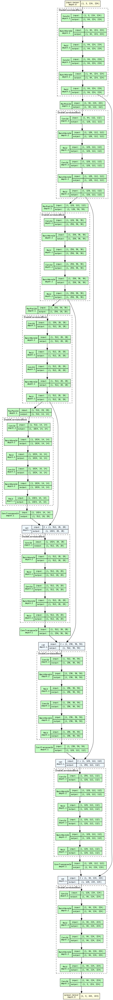

In [ ]:

graphviz.set_jupyter_format('png')

model_graph= draw_graph(
    Unet_Model(),
    input_size= (1, 3, 224, 224 ),
     roll= True, expand_nested= True
)

model_graph.visual_graph

In [ ]:


#Define Loss Function
loss_fn =nn.BCEWithLogitsLoss()

#Define Optimizer
optimizer= torch.optim.AdamW(
    unet_model.parameters(),
    lr=  LR
)

scheduler= lr_scheduler.ReduceLROnPlateau(

            optimizer=optimizer,
            mode= 'min',
            patience= PATIENCE,
            verbose= True

)

In [ ]:


print('Training U-Net Model')
print(f'Train on {len(train_df)} samples, validation on {len(val_df)} samples')
print("------------------------------------------")

#Generate Training Session Config

session_config={
    'model' : unet_model,
    'train_dataloader' : train_dl,
    'eval_dataloader' : val_dl,
    'optimizer' : optimizer,
    'scheduler' : scheduler,
    'loss_fn' : loss_fn,
    'epochs' : EPOCHS,
    'device' : DEVICE


}

unet_session_history= train(**session_config)

Training U-Net Model
Train on 2750 samples, validation on 412 samples
------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Training Model 
 Epoch 1 / 100



  1%|          | 1/100 [02:00<3:18:23, 120.24s/it]

loss: 0.4222 - dice_score: 0.2485 - eval_loss: 0.3274 - eval_dice: 0.4883 lr : 0.0001
Training Model 
 Epoch 2 / 100



  2%|▏         | 2/100 [03:59<3:15:30, 119.70s/it]

loss: 0.2880 - dice_score: 0.3734 - eval_loss: 0.2722 - eval_dice: 0.4296 lr : 0.0001
Training Model 
 Epoch 3 / 100



  3%|▎         | 3/100 [05:58<3:13:03, 119.42s/it]

loss: 0.2491 - dice_score: 0.4640 - eval_loss: 0.2322 - eval_dice: 0.5884 lr : 0.0001
Training Model 
 Epoch 4 / 100



  4%|▍         | 4/100 [07:57<3:10:46, 119.23s/it]

loss: 0.2135 - dice_score: 0.5445 - eval_loss: 0.1982 - eval_dice: 0.6769 lr : 0.0001
Training Model 
 Epoch 5 / 100



  5%|▌         | 5/100 [09:56<3:08:38, 119.14s/it]

loss: 0.1881 - dice_score: 0.6007 - eval_loss: 0.1759 - eval_dice: 0.6717 lr : 0.0001
Training Model 
 Epoch 6 / 100



  6%|▌         | 6/100 [11:56<3:06:51, 119.27s/it]

loss: 0.1659 - dice_score: 0.6125 - eval_loss: 0.1547 - eval_dice: 0.7040 lr : 0.0001
Training Model 
 Epoch 7 / 100



  7%|▋         | 7/100 [13:55<3:04:50, 119.25s/it]

loss: 0.1459 - dice_score: 0.6570 - eval_loss: 0.1357 - eval_dice: 0.7073 lr : 0.0001
Training Model 
 Epoch 8 / 100



100%|██████████| 86/86 [01:52<00:00,  1.31s/it]


loss: 0.1290 - dice_score: 0.6752 - eval_loss: 0.1218 - eval_dice: 0.6882 lr : 0.0001
Training Model 
 Epoch 9 / 100



  9%|▉         | 9/100 [17:53<3:00:50, 119.23s/it]

loss: 0.1143 - dice_score: 0.6916 - eval_loss: 0.1061 - eval_dice: 0.7131 lr : 0.0001
Training Model 
 Epoch 10 / 100



 10%|█         | 10/100 [19:52<2:58:49, 119.22s/it]

loss: 0.1018 - dice_score: 0.6991 - eval_loss: 0.0950 - eval_dice: 0.7509 lr : 0.0001
Training Model 
 Epoch 11 / 100



 11%|█         | 11/100 [21:52<2:56:57, 119.30s/it]

loss: 0.0911 - dice_score: 0.7237 - eval_loss: 0.0850 - eval_dice: 0.7580 lr : 0.0001
Training Model 
 Epoch 12 / 100



 12%|█▏        | 12/100 [23:51<2:55:03, 119.36s/it]

loss: 0.0816 - dice_score: 0.7348 - eval_loss: 0.0763 - eval_dice: 0.7613 lr : 0.0001
Training Model 
 Epoch 13 / 100



 13%|█▎        | 13/100 [25:51<2:53:00, 119.32s/it]

loss: 0.0746 - dice_score: 0.7260 - eval_loss: 0.0685 - eval_dice: 0.7624 lr : 0.0001
Training Model 
 Epoch 14 / 100



 14%|█▍        | 14/100 [27:50<2:50:58, 119.29s/it]

loss: 0.0670 - dice_score: 0.7433 - eval_loss: 0.0609 - eval_dice: 0.7912 lr : 0.0001
Training Model 
 Epoch 15 / 100



 15%|█▌        | 15/100 [29:49<2:49:10, 119.42s/it]

loss: 0.0608 - dice_score: 0.7639 - eval_loss: 0.0570 - eval_dice: 0.7826 lr : 0.0001
Training Model 
 Epoch 16 / 100



 16%|█▌        | 16/100 [31:49<2:47:06, 119.36s/it]

loss: 0.0561 - dice_score: 0.7582 - eval_loss: 0.0529 - eval_dice: 0.7885 lr : 0.0001
Training Model 
 Epoch 17 / 100



 17%|█▋        | 17/100 [33:48<2:45:03, 119.32s/it]

loss: 0.0512 - dice_score: 0.7762 - eval_loss: 0.0486 - eval_dice: 0.8022 lr : 0.0001
Training Model 
 Epoch 18 / 100



 18%|█▊        | 18/100 [35:47<2:43:02, 119.29s/it]

loss: 0.0464 - dice_score: 0.7974 - eval_loss: 0.0444 - eval_dice: 0.8329 lr : 0.0001
Training Model 
 Epoch 19 / 100



 19%|█▉        | 19/100 [37:47<2:41:17, 119.48s/it]

loss: 0.0435 - dice_score: 0.7870 - eval_loss: 0.0434 - eval_dice: 0.7531 lr : 0.0001
Training Model 
 Epoch 20 / 100



 20%|██        | 20/100 [39:47<2:39:34, 119.68s/it]

loss: 0.0401 - dice_score: 0.7939 - eval_loss: 0.0392 - eval_dice: 0.8328 lr : 0.0001
Training Model 
 Epoch 21 / 100



 21%|██        | 21/100 [41:47<2:37:30, 119.63s/it]

loss: 0.0372 - dice_score: 0.8026 - eval_loss: 0.0354 - eval_dice: 0.8187 lr : 0.0001
Training Model 
 Epoch 22 / 100



 22%|██▏       | 22/100 [43:46<2:35:29, 119.61s/it]

loss: 0.0339 - dice_score: 0.8248 - eval_loss: 0.0318 - eval_dice: 0.8194 lr : 0.0001
Training Model 
 Epoch 23 / 100



 23%|██▎       | 23/100 [45:46<2:33:31, 119.63s/it]

loss: 0.0319 - dice_score: 0.8176 - eval_loss: 0.0290 - eval_dice: 0.8472 lr : 0.0001
Training Model 
 Epoch 24 / 100



 24%|██▍       | 24/100 [47:45<2:31:21, 119.50s/it]

loss: 0.0296 - dice_score: 0.8267 - eval_loss: 0.0269 - eval_dice: 0.8537 lr : 0.0001
Training Model 
 Epoch 25 / 100



 25%|██▌       | 25/100 [49:45<2:29:22, 119.50s/it]

loss: 0.0277 - dice_score: 0.8300 - eval_loss: 0.0248 - eval_dice: 0.8671 lr : 0.0001
Training Model 
 Epoch 26 / 100



 26%|██▌       | 26/100 [51:44<2:27:25, 119.54s/it]

loss: 0.0256 - dice_score: 0.8409 - eval_loss: 0.0259 - eval_dice: 0.8321 lr : 0.0001
Training Model 
 Epoch 27 / 100



 27%|██▋       | 27/100 [53:44<2:25:29, 119.58s/it]

loss: 0.0244 - dice_score: 0.8400 - eval_loss: 0.0227 - eval_dice: 0.8705 lr : 0.0001
Training Model 
 Epoch 28 / 100



 28%|██▊       | 28/100 [55:43<2:23:26, 119.53s/it]

loss: 0.0223 - dice_score: 0.8582 - eval_loss: 0.0214 - eval_dice: 0.8628 lr : 0.0001
Training Model 
 Epoch 29 / 100



 29%|██▉       | 29/100 [57:43<2:21:29, 119.57s/it]

loss: 0.0218 - dice_score: 0.8416 - eval_loss: 0.0239 - eval_dice: 0.8121 lr : 0.0001
Training Model 
 Epoch 30 / 100



 30%|███       | 30/100 [59:43<2:19:33, 119.61s/it]

loss: 0.0210 - dice_score: 0.8389 - eval_loss: 0.0201 - eval_dice: 0.8506 lr : 0.0001
Training Model 
 Epoch 31 / 100



 31%|███       | 31/100 [1:01:43<2:17:36, 119.66s/it]

loss: 0.0198 - dice_score: 0.8445 - eval_loss: 0.0188 - eval_dice: 0.8646 lr : 0.0001
Training Model 
 Epoch 32 / 100



 32%|███▏      | 32/100 [1:03:42<2:15:38, 119.69s/it]

loss: 0.0182 - dice_score: 0.8593 - eval_loss: 0.0172 - eval_dice: 0.8781 lr : 0.0001
Training Model 
 Epoch 33 / 100



 33%|███▎      | 33/100 [1:05:42<2:13:43, 119.76s/it]

loss: 0.0175 - dice_score: 0.8565 - eval_loss: 0.0163 - eval_dice: 0.8731 lr : 0.0001
Training Model 
 Epoch 34 / 100



 34%|███▍      | 34/100 [1:07:42<2:11:39, 119.69s/it]

loss: 0.0168 - dice_score: 0.8511 - eval_loss: 0.0178 - eval_dice: 0.8471 lr : 0.0001
Training Model 
 Epoch 35 / 100



 35%|███▌      | 35/100 [1:09:41<2:09:35, 119.63s/it]

loss: 0.0160 - dice_score: 0.8605 - eval_loss: 0.0149 - eval_dice: 0.8762 lr : 0.0001
Training Model 
 Epoch 36 / 100



 36%|███▌      | 36/100 [1:11:41<2:07:38, 119.66s/it]

loss: 0.0154 - dice_score: 0.8611 - eval_loss: 0.0140 - eval_dice: 0.8881 lr : 0.0001
Training Model 
 Epoch 37 / 100



 37%|███▋      | 37/100 [1:13:41<2:05:40, 119.69s/it]

loss: 0.0146 - dice_score: 0.8670 - eval_loss: 0.0137 - eval_dice: 0.8789 lr : 0.0001
Training Model 
 Epoch 38 / 100



 38%|███▊      | 38/100 [1:15:40<2:03:40, 119.69s/it]

loss: 0.0138 - dice_score: 0.8739 - eval_loss: 0.0126 - eval_dice: 0.8893 lr : 0.0001
Training Model 
 Epoch 39 / 100



 39%|███▉      | 39/100 [1:17:40<2:01:37, 119.63s/it]

loss: 0.0129 - dice_score: 0.8799 - eval_loss: 0.0125 - eval_dice: 0.8842 lr : 0.0001
Training Model 
 Epoch 40 / 100



 40%|████      | 40/100 [1:19:40<1:59:44, 119.75s/it]

loss: 0.0131 - dice_score: 0.8710 - eval_loss: 0.0125 - eval_dice: 0.8882 lr : 0.0001
Training Model 
 Epoch 41 / 100



 41%|████      | 41/100 [1:21:40<1:57:43, 119.72s/it]

loss: 0.0120 - dice_score: 0.8828 - eval_loss: 0.0114 - eval_dice: 0.8865 lr : 0.0001
Training Model 
 Epoch 42 / 100



 42%|████▏     | 42/100 [1:23:39<1:55:45, 119.74s/it]

loss: 0.0116 - dice_score: 0.8814 - eval_loss: 0.0113 - eval_dice: 0.8861 lr : 0.0001
Training Model 
 Epoch 43 / 100



 43%|████▎     | 43/100 [1:25:39<1:53:47, 119.78s/it]

loss: 0.0110 - dice_score: 0.8840 - eval_loss: 0.0109 - eval_dice: 0.8893 lr : 0.0001
Training Model 
 Epoch 44 / 100



 44%|████▍     | 44/100 [1:27:39<1:51:49, 119.82s/it]

loss: 0.0109 - dice_score: 0.8818 - eval_loss: 0.0110 - eval_dice: 0.8914 lr : 0.0001
Training Model 
 Epoch 45 / 100



 45%|████▌     | 45/100 [1:29:39<1:49:46, 119.75s/it]

loss: 0.0107 - dice_score: 0.8825 - eval_loss: 0.0108 - eval_dice: 0.8704 lr : 0.0001
Training Model 
 Epoch 46 / 100



 46%|████▌     | 46/100 [1:31:39<1:47:46, 119.75s/it]

loss: 0.0101 - dice_score: 0.8875 - eval_loss: 0.0099 - eval_dice: 0.8871 lr : 0.0001
Training Model 
 Epoch 47 / 100



100%|██████████| 86/86 [01:53<00:00,  1.32s/it]


loss: 0.0105 - dice_score: 0.8759 - eval_loss: 0.0098 - eval_dice: 0.8865 lr : 0.0001
Training Model 
 Epoch 48 / 100



 48%|████▊     | 48/100 [1:35:38<1:43:45, 119.73s/it]

loss: 0.0099 - dice_score: 0.8830 - eval_loss: 0.0094 - eval_dice: 0.8883 lr : 0.0001
Training Model 
 Epoch 49 / 100



 49%|████▉     | 49/100 [1:37:38<1:41:45, 119.71s/it]

loss: 0.0097 - dice_score: 0.8819 - eval_loss: 0.0095 - eval_dice: 0.8877 lr : 0.0001
Training Model 
 Epoch 50 / 100



 50%|█████     | 50/100 [1:39:38<1:39:49, 119.80s/it]

loss: 0.0094 - dice_score: 0.8864 - eval_loss: 0.0094 - eval_dice: 0.8862 lr : 0.0001
Training Model 
 Epoch 51 / 100



 51%|█████     | 51/100 [1:41:37<1:37:47, 119.75s/it]

loss: 0.0088 - dice_score: 0.8897 - eval_loss: 0.0088 - eval_dice: 0.8937 lr : 0.0001
Training Model 
 Epoch 52 / 100



 52%|█████▏    | 52/100 [1:43:37<1:35:47, 119.74s/it]

loss: 0.0080 - dice_score: 0.9028 - eval_loss: 0.0086 - eval_dice: 0.8915 lr : 0.0001
Training Model 
 Epoch 53 / 100



 53%|█████▎    | 53/100 [1:45:37<1:33:47, 119.74s/it]

loss: 0.0082 - dice_score: 0.8940 - eval_loss: 0.0088 - eval_dice: 0.8910 lr : 0.0001
Training Model 
 Epoch 54 / 100



 54%|█████▍    | 54/100 [1:47:36<1:31:48, 119.75s/it]

loss: 0.0086 - dice_score: 0.8870 - eval_loss: 0.0090 - eval_dice: 0.8861 lr : 0.0001
Training Model 
 Epoch 55 / 100



 55%|█████▌    | 55/100 [1:49:36<1:29:51, 119.81s/it]

loss: 0.0084 - dice_score: 0.8824 - eval_loss: 0.0083 - eval_dice: 0.8822 lr : 0.0001
Training Model 
 Epoch 56 / 100



 56%|█████▌    | 56/100 [1:51:36<1:27:52, 119.83s/it]

loss: 0.0079 - dice_score: 0.8910 - eval_loss: 0.0082 - eval_dice: 0.8836 lr : 0.0001
Training Model 
 Epoch 57 / 100



 57%|█████▋    | 57/100 [1:53:36<1:25:53, 119.84s/it]

loss: 0.0081 - dice_score: 0.8896 - eval_loss: 0.0080 - eval_dice: 0.8810 lr : 0.0001
Training Model 
 Epoch 58 / 100



 58%|█████▊    | 58/100 [1:55:36<1:23:54, 119.88s/it]

loss: 0.0088 - dice_score: 0.8709 - eval_loss: 0.0086 - eval_dice: 0.8723 lr : 0.0001
Training Model 
 Epoch 59 / 100



 59%|█████▉    | 59/100 [1:57:36<1:21:58, 119.95s/it]

loss: 0.0083 - dice_score: 0.8753 - eval_loss: 0.0080 - eval_dice: 0.8880 lr : 0.0001
Training Model 
 Epoch 60 / 100



 60%|██████    | 60/100 [1:59:36<1:19:53, 119.83s/it]

loss: 0.0079 - dice_score: 0.8849 - eval_loss: 0.0075 - eval_dice: 0.8866 lr : 0.0001
Training Model 
 Epoch 61 / 100



 61%|██████    | 61/100 [2:01:35<1:17:50, 119.76s/it]

loss: 0.0069 - dice_score: 0.9022 - eval_loss: 0.0070 - eval_dice: 0.8963 lr : 0.0001
Training Model 
 Epoch 62 / 100



 62%|██████▏   | 62/100 [2:03:35<1:15:49, 119.73s/it]

loss: 0.0068 - dice_score: 0.9006 - eval_loss: 0.0068 - eval_dice: 0.8953 lr : 0.0001
Training Model 
 Epoch 63 / 100



 63%|██████▎   | 63/100 [2:05:35<1:13:52, 119.81s/it]

loss: 0.0066 - dice_score: 0.8996 - eval_loss: 0.0073 - eval_dice: 0.8899 lr : 0.0001
Training Model 
 Epoch 64 / 100



 64%|██████▍   | 64/100 [2:07:35<1:11:56, 119.91s/it]

loss: 0.0066 - dice_score: 0.9015 - eval_loss: 0.0068 - eval_dice: 0.9009 lr : 0.0001
Training Model 
 Epoch 65 / 100



 65%|██████▌   | 65/100 [2:09:35<1:09:59, 119.97s/it]

loss: 0.0064 - dice_score: 0.9042 - eval_loss: 0.0065 - eval_dice: 0.8956 lr : 0.0001
Training Model 
 Epoch 66 / 100



 66%|██████▌   | 66/100 [2:11:35<1:07:57, 119.92s/it]

loss: 0.0066 - dice_score: 0.9003 - eval_loss: 0.0076 - eval_dice: 0.8892 lr : 0.0001
Training Model 
 Epoch 67 / 100



 67%|██████▋   | 67/100 [2:13:36<1:06:02, 120.07s/it]

loss: 0.0067 - dice_score: 0.8987 - eval_loss: 0.0064 - eval_dice: 0.8977 lr : 0.0001
Training Model 
 Epoch 68 / 100



 68%|██████▊   | 68/100 [2:15:35<1:04:00, 120.03s/it]

loss: 0.0060 - dice_score: 0.9051 - eval_loss: 0.0061 - eval_dice: 0.9003 lr : 0.0001
Training Model 
 Epoch 69 / 100



 69%|██████▉   | 69/100 [2:17:35<1:01:58, 119.94s/it]

loss: 0.0059 - dice_score: 0.9029 - eval_loss: 0.0068 - eval_dice: 0.8901 lr : 0.0001
Training Model 
 Epoch 70 / 100



 70%|███████   | 70/100 [2:19:35<59:59, 119.97s/it]  

loss: 0.0066 - dice_score: 0.8926 - eval_loss: 0.0076 - eval_dice: 0.8818 lr : 0.0001
Training Model 
 Epoch 71 / 100



 71%|███████   | 71/100 [2:21:35<58:00, 120.03s/it]

loss: 0.0081 - dice_score: 0.8642 - eval_loss: 0.0070 - eval_dice: 0.8921 lr : 0.0001
Training Model 
 Epoch 72 / 100



 72%|███████▏  | 72/100 [2:23:36<56:01, 120.06s/it]

loss: 0.0062 - dice_score: 0.8958 - eval_loss: 0.0061 - eval_dice: 0.8994 lr : 0.0001
Training Model 
 Epoch 73 / 100



 73%|███████▎  | 73/100 [2:25:36<54:02, 120.10s/it]

loss: 0.0059 - dice_score: 0.9016 - eval_loss: 0.0060 - eval_dice: 0.9014 lr : 0.0001
Training Model 
 Epoch 74 / 100



 74%|███████▍  | 74/100 [2:27:36<52:02, 120.08s/it]

loss: 0.0055 - dice_score: 0.9086 - eval_loss: 0.0060 - eval_dice: 0.8994 lr : 0.0001
Training Model 
 Epoch 75 / 100



 75%|███████▌  | 75/100 [2:29:36<50:00, 120.01s/it]

loss: 0.0053 - dice_score: 0.9096 - eval_loss: 0.0060 - eval_dice: 0.8990 lr : 0.0001
Training Model 
 Epoch 76 / 100



 76%|███████▌  | 76/100 [2:31:35<47:58, 119.93s/it]

loss: 0.0054 - dice_score: 0.9089 - eval_loss: 0.0058 - eval_dice: 0.8990 lr : 0.0001
Training Model 
 Epoch 77 / 100



 77%|███████▋  | 77/100 [2:33:35<45:58, 119.95s/it]

loss: 0.0054 - dice_score: 0.9068 - eval_loss: 0.0064 - eval_dice: 0.8885 lr : 0.0001
Training Model 
 Epoch 78 / 100



 78%|███████▊  | 78/100 [2:35:35<43:57, 119.90s/it]

loss: 0.0050 - dice_score: 0.9151 - eval_loss: 0.0060 - eval_dice: 0.8975 lr : 0.0001
Training Model 
 Epoch 79 / 100



 79%|███████▉  | 79/100 [2:37:35<41:58, 119.91s/it]

loss: 0.0050 - dice_score: 0.9130 - eval_loss: 0.0061 - eval_dice: 0.8977 lr : 0.0001
Training Model 
 Epoch 80 / 100



 80%|████████  | 80/100 [2:39:35<39:58, 119.95s/it]

loss: 0.0067 - dice_score: 0.8858 - eval_loss: 0.0073 - eval_dice: 0.8712 lr : 0.0001
Training Model 
 Epoch 81 / 100



 81%|████████  | 81/100 [2:41:35<37:59, 119.97s/it]

loss: 0.0061 - dice_score: 0.8942 - eval_loss: 0.0068 - eval_dice: 0.8817 lr : 0.0001
Training Model 
 Epoch 82 / 100



 82%|████████▏ | 82/100 [2:43:35<35:59, 119.97s/it]

loss: 0.0057 - dice_score: 0.9008 - eval_loss: 0.0058 - eval_dice: 0.9006 lr : 0.0001
Training Model 
 Epoch 83 / 100



 83%|████████▎ | 83/100 [2:45:35<34:00, 120.06s/it]

loss: 0.0051 - dice_score: 0.9085 - eval_loss: 0.0056 - eval_dice: 0.9001 lr : 0.0001
Training Model 
 Epoch 84 / 100



 84%|████████▍ | 84/100 [2:47:36<32:02, 120.14s/it]

loss: 0.0050 - dice_score: 0.9103 - eval_loss: 0.0062 - eval_dice: 0.8892 lr : 0.0001
Training Model 
 Epoch 85 / 100



 85%|████████▌ | 85/100 [2:49:36<30:02, 120.15s/it]

loss: 0.0053 - dice_score: 0.9023 - eval_loss: 0.0061 - eval_dice: 0.8931 lr : 0.0001
Training Model 
 Epoch 86 / 100



 86%|████████▌ | 86/100 [2:51:36<28:03, 120.23s/it]

loss: 0.0057 - dice_score: 0.8989 - eval_loss: 0.0057 - eval_dice: 0.8977 lr : 0.0001
Training Model 
 Epoch 87 / 100



 87%|████████▋ | 87/100 [2:53:36<26:02, 120.21s/it]

loss: 0.0051 - dice_score: 0.9058 - eval_loss: 0.0054 - eval_dice: 0.9012 lr : 0.0001
Training Model 
 Epoch 88 / 100



 88%|████████▊ | 88/100 [2:55:37<24:02, 120.19s/it]

loss: 0.0048 - dice_score: 0.9099 - eval_loss: 0.0053 - eval_dice: 0.9013 lr : 0.0001
Training Model 
 Epoch 89 / 100



 89%|████████▉ | 89/100 [2:57:37<22:01, 120.13s/it]

loss: 0.0048 - dice_score: 0.9120 - eval_loss: 0.0061 - eval_dice: 0.8942 lr : 0.0001
Training Model 
 Epoch 90 / 100



 90%|█████████ | 90/100 [2:59:37<20:01, 120.13s/it]

loss: 0.0050 - dice_score: 0.9115 - eval_loss: 0.0055 - eval_dice: 0.8996 lr : 0.0001
Training Model 
 Epoch 91 / 100



 91%|█████████ | 91/100 [3:01:37<18:00, 120.08s/it]

loss: 0.0047 - dice_score: 0.9141 - eval_loss: 0.0055 - eval_dice: 0.9033 lr : 0.0001
Training Model 
 Epoch 92 / 100



 92%|█████████▏| 92/100 [3:03:37<16:00, 120.07s/it]

loss: 0.0050 - dice_score: 0.9089 - eval_loss: 0.0060 - eval_dice: 0.8947 lr : 0.0001
Training Model 
 Epoch 93 / 100



 93%|█████████▎| 93/100 [3:05:37<14:00, 120.02s/it]

loss: 0.0046 - dice_score: 0.9158 - eval_loss: 0.0054 - eval_dice: 0.8963 lr : 0.0001
Training Model 
 Epoch 94 / 100



 94%|█████████▍| 94/100 [3:07:37<12:01, 120.20s/it]

loss: 0.0045 - dice_score: 0.9178 - eval_loss: 0.0063 - eval_dice: 0.8990 lr : 0.0001
Training Model 
 Epoch 95 / 100



 95%|█████████▌| 95/100 [3:09:37<10:00, 120.17s/it]

loss: 0.0042 - dice_score: 0.9194 - eval_loss: 0.0054 - eval_dice: 0.9024 lr : 0.0001
Training Model 
 Epoch 96 / 100



 96%|█████████▌| 96/100 [3:11:38<08:00, 120.20s/it]

loss: 0.0045 - dice_score: 0.9146 - eval_loss: 0.0054 - eval_dice: 0.8952 lr : 0.0001
Training Model 
 Epoch 97 / 100



 97%|█████████▋| 97/100 [3:13:38<06:00, 120.23s/it]

Epoch 00097: reducing learning rate of group 0 to 1.0000e-05.
loss: 0.0044 - dice_score: 0.9177 - eval_loss: 0.0063 - eval_dice: 0.8863 lr : 1e-05
Training Model 
 Epoch 98 / 100



 98%|█████████▊| 98/100 [3:15:38<04:00, 120.17s/it]

loss: 0.0044 - dice_score: 0.9175 - eval_loss: 0.0055 - eval_dice: 0.9024 lr : 1e-05
Training Model 
 Epoch 99 / 100



 99%|█████████▉| 99/100 [3:17:38<02:00, 120.17s/it]

loss: 0.0039 - dice_score: 0.9244 - eval_loss: 0.0053 - eval_dice: 0.9015 lr : 1e-05
Training Model 
 Epoch 100 / 100



100%|██████████| 100/100 [3:19:38<00:00, 119.79s/it]

loss: 0.0040 - dice_score: 0.9250 - eval_loss: 0.0054 - eval_dice: 0.9028 lr : 1e-05


In [ ]:
model_name= 'unet_model'
model_path= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/'

torch.save(unet_model, model_path+model_name + '.pth')

In [ ]:
path_= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/unet_model.pth'

In [ ]:
sample_model= torch.load(path_)

In [ ]:
sample_model.eval()

Unet_Model(
  (encoder): ModuleList(
    (0): DoubleConvolutionBlock(
      (conv_layer1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv_layer2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (act1): ReLU(inplace=True)
      (act2): ReLU(inplace=True)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): DoubleConvolutionBlock(
      (conv_layer1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv_layer2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (act1): ReLU(inplace=True)
      (act2): ReLU(inplace=True)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (2): DoubleConvolutionBlo

In [ ]:
unet_test_masks= predict(
    sample_model, test_dl, device= DEVICE, threshold= 0.5
)

100%|██████████| 24/24 [00:11<00:00,  2.16it/s]


In [ ]:
def view_multiple_predictions(
    model,ds, color_map= 'rgb', fig_size= (14, 10), title_size= 16, count=10
):

  idx= random.sample(list(range(len(ds))), count)

  #Initialise figure
  fig= plt.figure(figsize= fig_size);
  fig.tight_layout();
  fig.subplots_adjust(top= 0.95)

  for row, _ in enumerate(idx):
    image, mask= ds[_]
    idx= 3* (row+1)

    #Plot MRI Image
    plt.subplot(count+1, 3, idx+1)
    plt.title("MRI Image", fontsize= title_size)
    if color_map == 'rgb':
      plt.imshow(image.permute(1, 2, 0))
    else:
      plt.imshow(image.permute(1, 2, 0), cmap= color_map)

    #Plot Mask
    plt.subplot(count+1, 3, idx+2)
    plt.title("Mask", fontsize= title_size)
    plt.imshow(mask.permute(1, 2, 0), cmap= 'gray')

    #Generate Predicted Mask
    mri_input= torch.unsqueeze(torch.tensor(image), dim=0).to(torch.device('cuda'))


    with torch.inference_mode():
      pred_mask= model(mri_input)
      pred_mask= torch.sigmoid(pred_mask).cpu()
      pred_mask= (pred_mask > 0.5)

    plt.subplot(count+1, 3, idx +3)
    plt.title("Predicted Mask", fontsize= title_size)

    plt.imshow(pred_mask[0].permute(1, 2, 0), cmap= 'gray')
  return

In [ ]:
unet_test= test_df.copy()

test_diagnosed_ds= MRISegmentationDataset(unet_test[unet_test['diagnosis']==1].reset_index(drop=True), transform= inference_transforms)


<ipython-input-60-7e539dcd27af>:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mri_input= torch.unsqueeze(torch.tensor(image), dim=0).to(torch.device('cuda'))


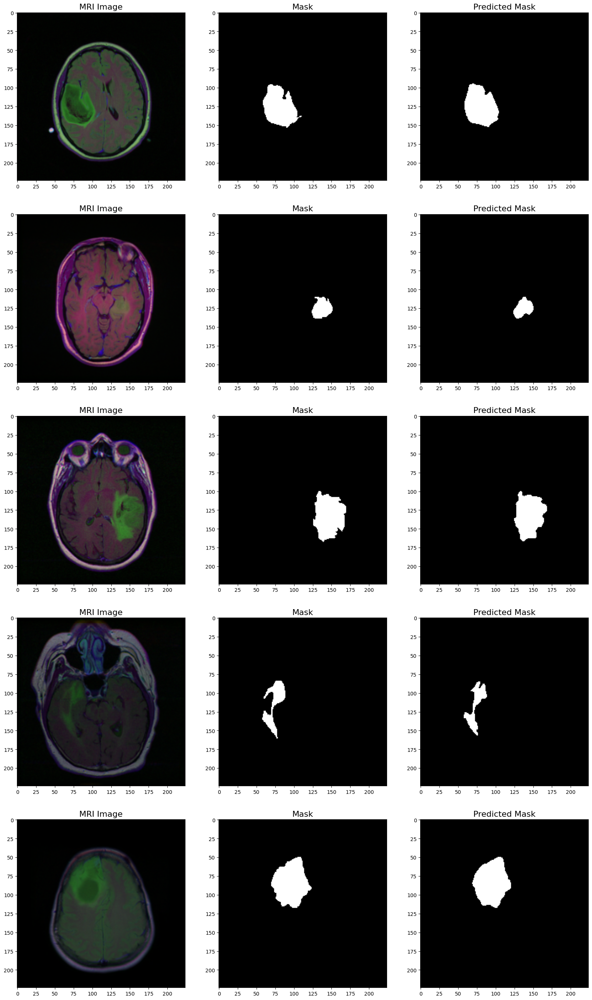

In [ ]:
view_multiple_predictions(sample_model, test_diagnosed_ds, count=5, color_map= 'rgb', fig_size=(20,38))

In [ ]:
def plot_training_curves(history, fig_size= (16,8), titile_size= 16):

  loss= np.array(history['loss'])
  val_loss= np.array(history['eval_loss'])
  dice_coef= np.array(history['loss_score'])
  eval_dice_coef= np.array(history['eval_score'])

  epochs= range(len(history['loss']))

  fig, (ax1, ax2)= plt.subplots(2, 1, figsize= fig_size)

  ax1.plot(epochs, loss, label= 'Training Loss', marker= 'o', color= 'C5');
  ax1.plot(epochs, val_loss, label= 'Validation Loss', marker= 'o', color= 'C6');

  #Filling area between losses
  ax1.fill_between(epochs, loss, val_loss, where= (loss > val_loss), color= 'C5', alpha= 0.4, interpolate= True);
  ax2.fill_between(epochs, loss, val_loss, where= (loss< val_loss), color= 'C6', alpha= 0.4, interpolate= True);


  # Adding formatting
  ax1.set_title('Loss - The Lower The Better', fontsize= 22);
  ax1.set_xlabel('Epochs', fontsize= 18);
  ax1.set_ylabel('Loss', fontsize= 18);
  ax1.tick_params(axis= 'both', which= 'major', labelsize= 14);
  ax1.legend(fontsize= 14)

  ax2.plot(epochs, dice_coef, label= 'Training Dice Score', marker= 'o', color= 'C5')
  ax2.plot(epochs, eval_dice_coef, label= 'Validation Dice Score', marker= 'o', color= 'C6')

  ax2.fill_between(epochs, dice_coef, eval_dice_coef, where= (dice_coef > eval_dice_coef), color= 'C5', alpha= 0.4, interpolate= True);
  ax2.fill_between(epochs, dice_coef, eval_dice_coef, where= (dice_coef < eval_dice_coef), color= 'C6', alpha= 0.4 , interpolate= True);

  ax2.set_title('Dice Score - The Higher The Better', fontsize= 22);
  ax2.set_xlabel('Epochs', fontsize= 18);
  ax2.set_ylabel('Dice Score', fontsize= 18);
  ax2.tick_params(axis= 'both', which= 'major', labelsize= 14);
  ax2.legend(fontsize= 14)

  sns.despine()

  return




In [ ]:
sample_df= pd.DataFrame(unet_session_history)

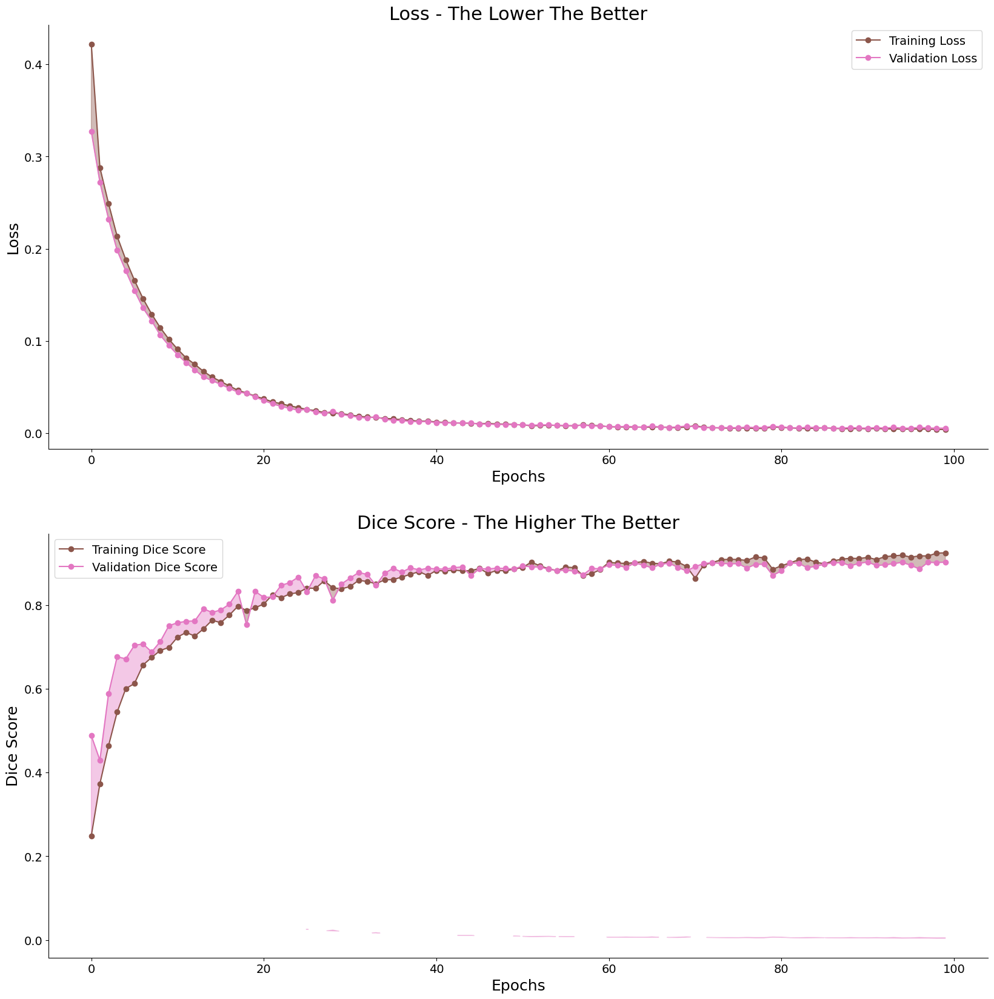

In [ ]:



plot_training_curves(unet_session_history, fig_size= (20, 20))

In [ ]:
def precision_(y_true, y_pred):
  intersection= (y_true * y_pred).sum()
  total_predicted_pixels= y_pred.sum()
  return (intersection/total_predicted_pixels).mean()

def recall_(y_true, y_pred):
  intersection= (y_true * y_pred).sum()
  total_true_pixels= y_true.sum()
  return (intersection/total_true_pixels).mean()

def dice_score(y_true, y_pred):
  eps= 1e-8
  intersection= (y_true * y_pred).sum()
  summation= (y_true + y_pred).sum()
  return ((2* intersection) / (summation + eps))

def jaccard_index(y_true, y_pred):
  eps= 1e-8
  intersection = (y_true * y_pred).sum()
  union= (y_true + y_pred).sum() - intersection
  return (intersection / (union+eps))


In [ ]:
def compute_metrics(
    model: nn.Module,
    sample_loader: torch.utils.data.DataLoader,
    device:torch.device
) -> np.ndarray:

  metrics= {
      'accuracy' : [],
      'precision': [],
      'recall' : [],
      'dice_score': [],
      'IoU': []
  }

  # Setting model into evaluation mode
  model.eval()

  with torch.inference_mode():

    for batch, (X, y) in enumerate(tqdm(sample_loader)):
      X= X.to(device)
      y= y.to(device)

      y_pred= model(X)

      predictions= torch.sigmoid(y_pred)
      predicted_class= (predictions > 0.3).float()

      # Computing Batch metrices for each mask
      for true_mask, pred_mask in zip(y, predicted_class):
        acc= ((true_mask == pred_mask ).sum() / torch.numel(true_mask)).cpu().item()
        prec= precision_(true_mask, pred_mask).cpu().item()
        rec= recall_(true_mask, pred_mask).cpu().item()
        dice= dice_score(true_mask, pred_mask).cpu().item()
        iou= jaccard_index(true_mask, pred_mask).cpu().item()

        metrics['accuracy'].append(acc)
        metrics['precision'].append(prec)
        metrics['recall'].append(rec)
        metrics['dice_score'].append(dice)
        metrics['IoU'].append(iou)

  return metrics













In [ ]:
unet_metrics= compute_metrics(sample_model, test_dl, DEVICE)

100%|██████████| 24/24 [00:11<00:00,  2.18it/s]


In [ ]:
# unet_metrics= compute_metrics(unet_model, test_dl, DEVICE)

In [ ]:
unet_test_df= test_df.copy()

unet_test_df= pd.concat((unet_test_df, pd.DataFrame(unet_metrics)), axis= 1)

#Generate Diagnosis Labels
unet_test_df['model_diagnosis']= [int(mask.max()) for mask in unet_test_masks]

unet_test_df

,id,patient,image_path,mask_path,diagnosis,accuracy,precision,recall,dice_score,IoU,model_diagnosis
0,22,TCGA_DU_A5TS_19970726,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.997110,0.738050,0.979695,0.841876,0.726930,1
1,11,TCGA_DU_8165_19970205,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
2,58,TCGA_HT_7881_19981015,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0,1.000000,NaN,NaN,0.000000,0.000000,0
3,19,TCGA_DU_5853_19950823,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
4,1,TCGA_DU_7298_19910324,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...
762,29,TCGA_DU_6399_19830416,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.998226,0.859016,0.994307,0.921724,0.854812,1
763,4,TCGA_DU_7294_19890104,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
764,11,TCGA_HT_8105_19980826,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0,1.000000,NaN,NaN,0.000000,0.000000,0
765,22,TCGA_DU_7014_19860618,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.997549,0.712821,0.674757,0.693267,0.530534,1


In [ ]:
def generate_performance_scores(y_true, y_pred, log= True):
  model_accuracy= accuracy_score(y_true, y_pred)
  model_precision, model_recall, model_f1, _= (precision_recall_fscore_support(y_true, y_pred, average= 'weighted'))

  model_matthews_corrcoeff= matthews_corrcoef(y_true, y_pred)

  if log:
    print("===============================================")
    print(f'accuracy_score:\t\t{model_accuracy:.4f}\n')
    print("===============================================")
    print(f'precision_score:\t{model_precision:.4f}\n')
    print("===============================================")
    print(f'recall_score:\t\t{model_recall:.4f}\n')
    print("===============================================")
    print(f'f1_score:\t\t{model_f1:.4f}\n')
    print("===============================================")
    print(f'mathhews_corrcoef:\t{model_matthews_corrcoeff:.4f}\n')
    print("===============================================")

  performance_metrics= {
      'accuracy_score': model_accuracy,
      'precision_score': model_precision,
      'recall_score': model_recall,
      'f1_score':model_f1,
      'matthews_corrcoef':model_matthews_corrcoeff
  }
  return performance_metrics





In [ ]:
test_labels= unet_test_df['diagnosis'].to_numpy()

unet_predictions= unet_test_df['model_diagnosis'].to_numpy()

In [ ]:
generate_performance_scores(test_labels, unet_predictions, log= True )

accuracy_score:		0.9752

precision_score:	0.9753

recall_score:		0.9752

f1_score:		0.9752

mathhews_corrcoef:	0.9456



{'accuracy_score': 0.9752281616688396,
 'precision_score': 0.9752530670561055,
 'recall_score': 0.9752281616688396,
 'f1_score': 0.9752388035064868,
 'matthews_corrcoef': 0.9455650609588531}